In [1]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt

from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.nn.utils.rnn import pad_sequence
from pathlib import Path


# Train paths
image_train = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/images/train"
label_train = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/labels/train"

# Val paths
image_val = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/images/val"
label_val = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/labels/val"


# # Define transformation with bounding box processing
transform = A.Compose([
    A.Resize(600, 960),  # Resize image & bounding boxes
    #A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels'],clip=True))  # Bounding boxes aligned

class AgroverseDataset(Dataset):
    def __init__(self, image_path, label_path, transform=None):
        self.image_root = Path(image_path)
        self.label_root = Path(label_path)
        self.transform = transform  # Albumentations transform

        self.image_dirs = sorted([d for d in self.image_root.iterdir() if d.is_dir()])
        self.label_dirs = sorted([d for d in self.label_root.iterdir() if d.is_dir()])
        self.data_pairs = self.create_data_pairs()

    def create_data_pairs(self):
        """Builds (prev, curr, label) pairs."""
        data_pairs = []
        for img_dir, lbl_dir in zip(self.image_dirs, self.label_dirs):
            img_folder = img_dir / "ring_front_center"
            lbl_folder = lbl_dir / "ring_front_center"

            if not img_folder.exists():
                continue

            images = sorted([f for f in img_folder.iterdir() if f.suffix == ".jpg"])
            labels = {f.stem: f for f in lbl_folder.iterdir() if f.suffix == ".txt"} if lbl_folder.exists() else {}

            for i in range(len(images)):  
                img_prev = images[i] if i == 0 else images[i - 1]
                img_curr = images[i]
                img_next = images[i] if i == len(images) - 1 else images[i + 1]
                
                # Get corresponding label for img_curr (instead of img_next)
                lbl_next = labels.get(img_next.stem, "EMPTY_BOUNDING_BOX")  
                data_pairs.append((str(img_prev), str(img_curr), str(lbl_next)))

        return data_pairs

    def __len__(self):
        return len(self.data_pairs)

    def __getitem__(self, idx):
        img_prev_path, img_curr_path, lbl_curr_path = self.data_pairs[idx]

        # Load images
        img_prev = cv2.imread(img_prev_path)
        img_curr = cv2.imread(img_curr_path)

        img_prev = cv2.cvtColor(img_prev, cv2.COLOR_BGR2RGB)
        img_curr = cv2.cvtColor(img_curr, cv2.COLOR_BGR2RGB)
        h, w, _ = img_curr.shape 

        # Load label or set empty bounding box
        if lbl_curr_path == "EMPTY_BOUNDING_BOX":
            bboxes = []  # No bounding boxes
            class_labels = []
        else:
            bboxes, class_labels = self.load_label(lbl_curr_path,w,h)

        # Apply transform to both images and labels
        transformed = self.transform(image=img_curr, bboxes=bboxes, class_labels=class_labels)
        img_curr = transformed["image"]
        bboxes = transformed["bboxes"]
        class_labels = transformed["class_labels"]
        transformed_prev = self.transform(image=img_prev, bboxes=bboxes, class_labels=class_labels)
        img_prev = transformed_prev["image"]

        # Convert bounding boxes and class labels to tensor
        if len(bboxes) > 0:
            labels = torch.tensor([[cls] + list(box) for cls, box in zip(class_labels, bboxes)], dtype=torch.float32)
        else:
            labels = torch.zeros((1, 5))  # Empty bounding box format: [class, x, y, w, h]

        return img_prev, img_curr, labels

    def load_label(self, label_path, img_width, img_height):
        """Loads bounding box labels from a text file and converts COCO format to YOLO format with clipping."""
        bboxes = []
        class_labels = []
        
        with open(label_path, "r") as f:
            for line in f.readlines():
                values = list(map(float, line.strip().split()))
                class_id = int(values[0])  # Class ID
                x_min, y_min, width, height = values[1:]  # COCO format
                x_center = (x_min + (width/2))/img_width
                y_center = (y_min + (height/2))/img_height
                width /= img_width
                height /= img_height
    
                class_labels.append(class_id)
                bboxes.append([x_center, y_center, width, height])
        
        return bboxes, class_labels




# Create dataset
dataset = AgroverseDataset(
    image_path=image_train, 
    label_path=label_train, 
    transform=transform
)

# # Define Collate Function for Padding Labels
# def collate_fn(batch):
#     imgs_prev, imgs_curr, labels = zip(*batch)  # Unpack batch

#     imgs_prev = torch.stack(imgs_prev)  # Stack images into a tensor
#     imgs_curr = torch.stack(imgs_curr)

#     # Pad labels to the max number of bounding boxes in the batch
#     labels = [torch.tensor(lbl) for lbl in labels]  # Convert lists to tensors
#     labels_padded = pad_sequence(labels, batch_first=True, padding_value=-1)  # Padding value -1

#     return imgs_prev, imgs_curr, labels_padded

# # Create DataLoader
# dataloader = DataLoader(dataset, batch_size=32, shuffle=True, collate_fn=collate_fn)

# # Iterate over data
# for img_prev, img_curr, labels in dataloader:
#     print(img_prev.shape, img_curr.shape, labels.shape)  # Expected: (32, 3, 640, 640)
#     break
def visualize(image, bboxes):
    
    h, w, _ = image.shape
    for bbox in bboxes:
        cls, x_center, y_center, width, height = bbox
        x_min = int((x_center - width / 2) * w)
        y_min = int((y_center - height / 2) * h)
        x_max = int((x_center + width / 2) * w)
        y_max = int((y_center + height / 2) * h)
        # Draw rectangle and label
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (255, 0, 0), 3)
        cv2.putText(image, f"Class {int(cls)}", (x_min, y_min - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)
        # Show image with bounding boxes
    plt.figure(figsize=(10, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.show()
    

In [2]:
img_prev1, img_curr1, labels2 = dataset[21000]
img_prev2, img_curr2, labels3 = dataset[21001]

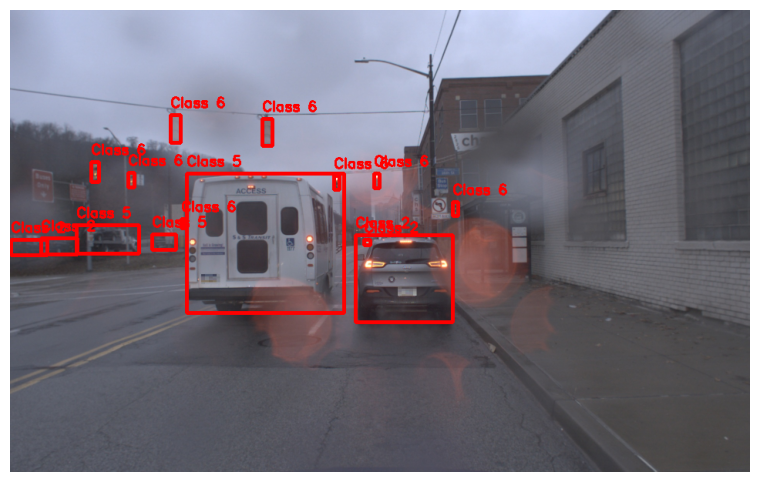

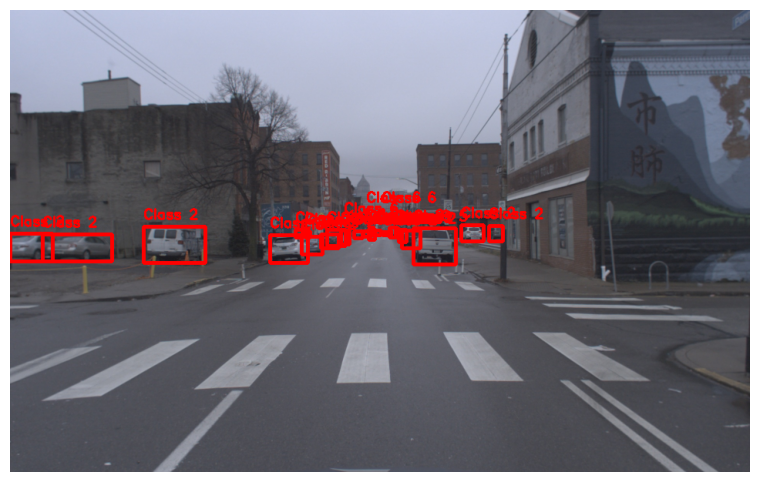

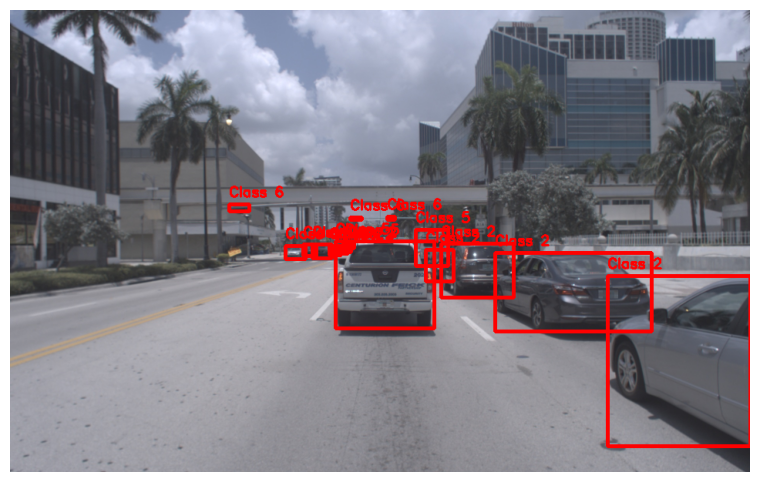

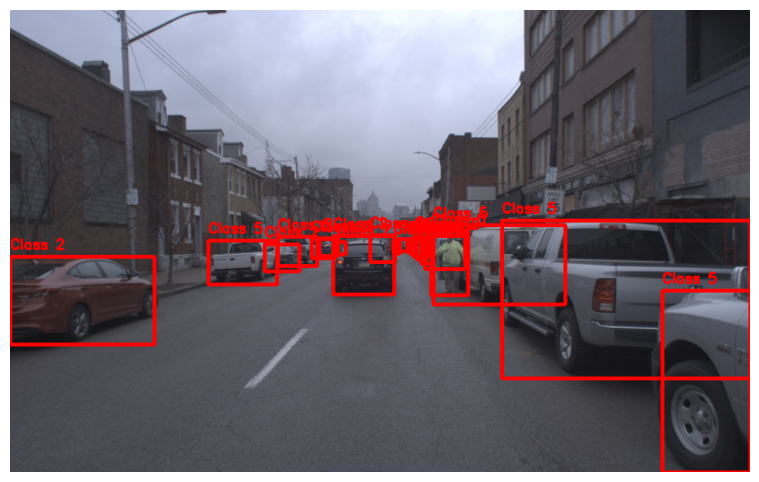

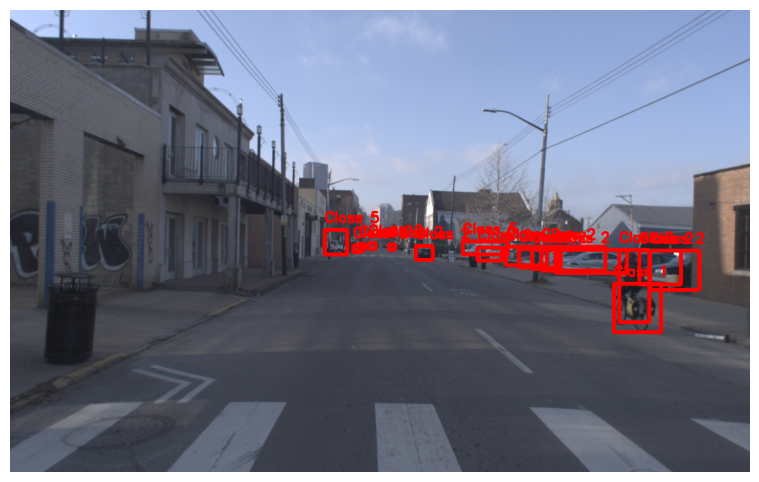

...

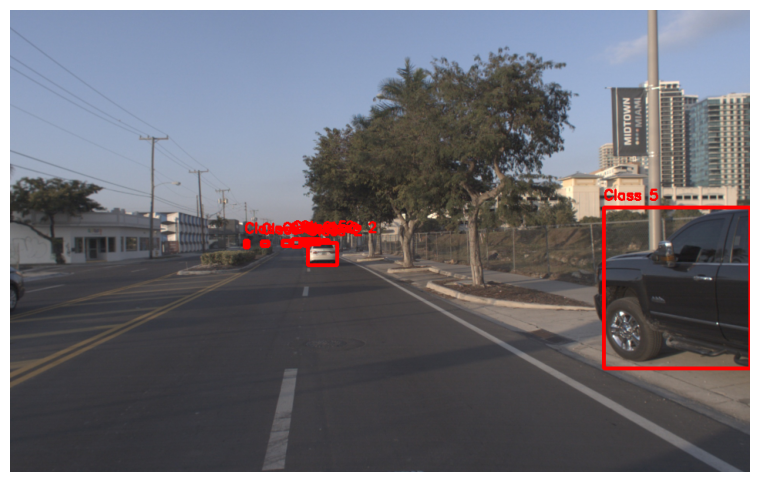

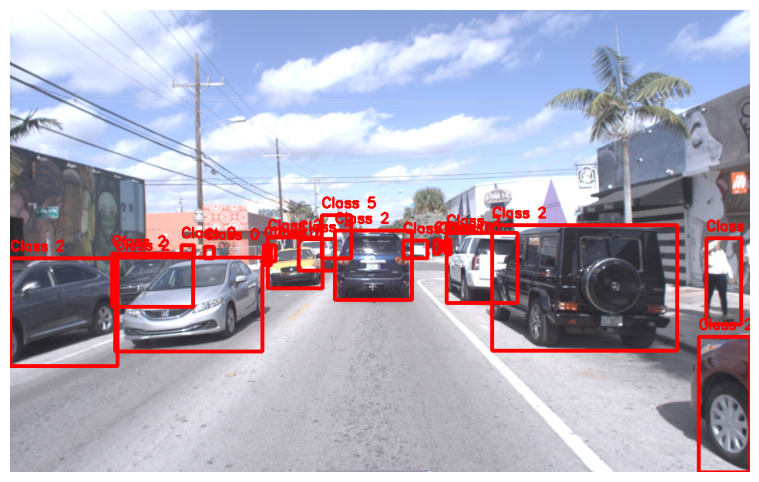

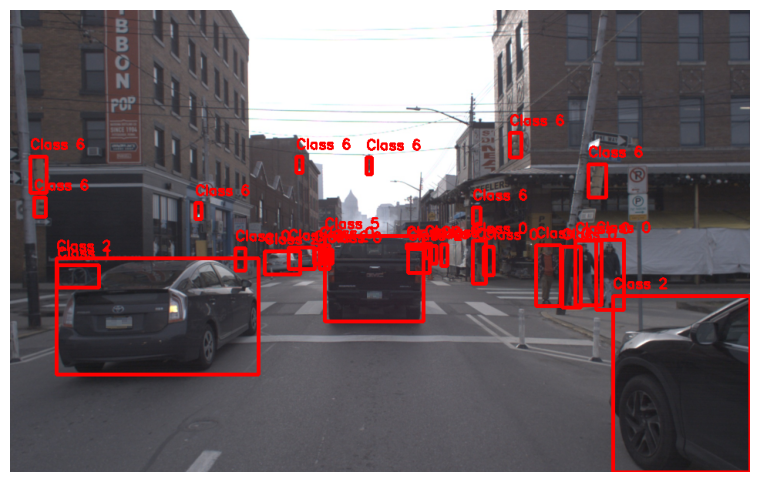

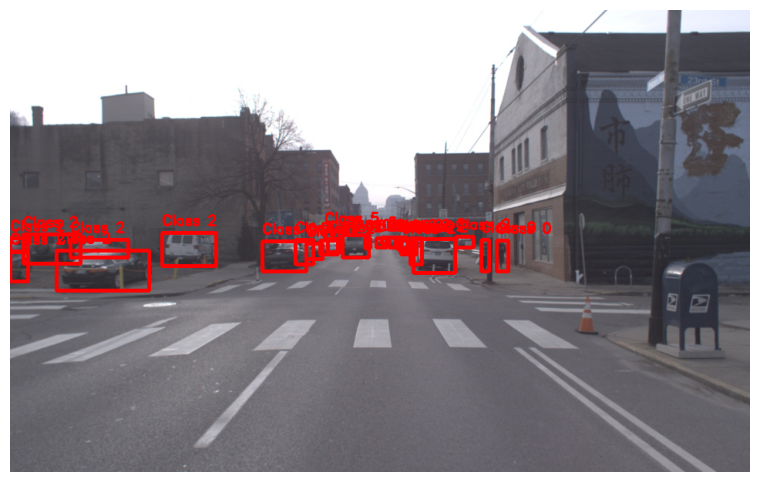

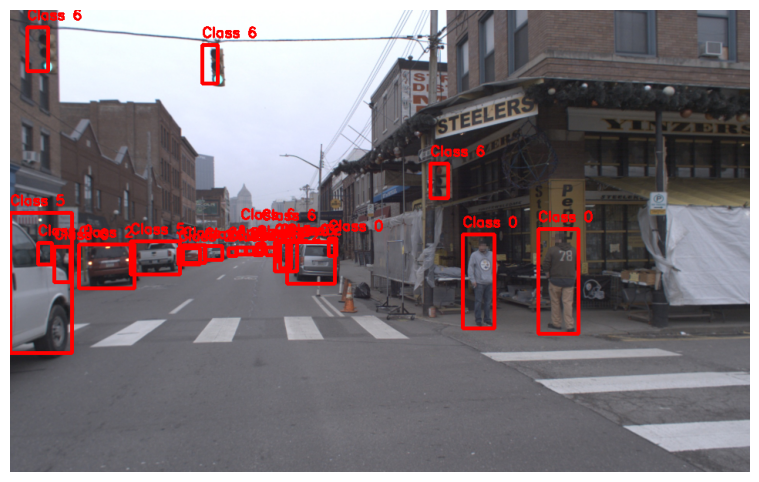

In [4]:
for i,(_,img, label) in enumerate(dataset):
    if i%1000 == 0:
        visualize(img.permute(1, 2, 0).numpy(), label)


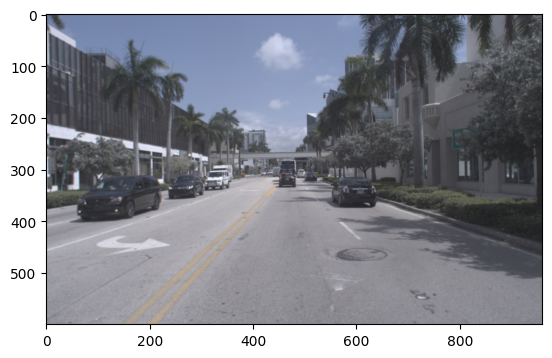

In [9]:
import torch
import matplotlib.pyplot as plt

# Create a random image tensor (C, H, W) format
#image_tensor = torch.rand(3, 640, 640)  # RGB Image with 3 channels

# Convert from CHW (C, H, W) to HWC (H, W, C) for matplotlib
image_np = img_curr1.permute(1, 2, 0).numpy()

# Display the image
plt.imshow(image_np)

In [5]:
# Define Collate Function for Padding Labels
def collate_fn(batch):
    imgs_prev, imgs_curr, labels = zip(*batch)  # Unpack batch

    imgs_prev = torch.stack(imgs_prev)  # Stack images into a tensor
    imgs_curr = torch.stack(imgs_curr)

    # Pad labels to the max number of bounding boxes in the batch
    labels = [torch.tensor(lbl) for lbl in labels]  # Convert lists to tensors
    labels_padded = pad_sequence(labels, batch_first=True, padding_value=-1)  # Padding value -1

    # valid_labels = []
    # for lbl in labels_padded:
    #     valid_labels.append(lbl[lbl[:, 0] != -1]) 
    

    return imgs_prev, imgs_curr, labels_padded

# Create DataLoader
train_dataloader = DataLoader(dataset, batch_size=32, shuffle=True, collate_fn=collate_fn)




In [6]:
# Iterate over data
for img_prev, img_curr, labels in train_dataloader:
    print(img_prev.shape, img_curr.shape, labels.shape)  # Example output
    break
    
    

torch.Size([32, 3, 600, 960]) torch.Size([32, 3, 600, 960]) torch.Size([32, 34, 5])


/tmp/ipykernel_991835/3456994924.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = [torch.tensor(lbl) for lbl in labels]  # Convert lists to tensors


In [17]:
from torchvision import transforms
from torch.utils.data import DataLoader
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader
from torch.utils.data.distributed import DistributedSampler
import torch.distributed as dist

if torch.distributed.is_available() and torch.distributed.is_initialized():
    print("Yes")
#sampler = DistributedSampler(dataset, shuffle=True)
# else:
    # sampler = None  # Use default sequential sampling

#dataloader = DataLoader(dataset, batch_size=32, sampler=sampler, collate_fn=collate_fn)

In [55]:
# Iterate over data
for img_prev, img_curr, labels in dataloader:
    print(img_prev.shape, img_curr.shape, labels.shape)  # Example output
    break

torch.Size([32, 3, 600, 960]) torch.Size([32, 3, 600, 960]) torch.Size([32, 15, 5])


/tmp/ipykernel_482901/1640725890.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = [torch.tensor(lbl) for lbl in labels]  # Convert lists to tensors


In [59]:
torch.distributed.is_available()

True

In [60]:
torch.distributed.is_initialized()

False

In [2]:
import torch.distributed as dist

# Check before initialization
print(dist.is_initialized())  # False

# Initialize process group (required for distributed training)

dist.init_process_group(backend="nccl", rank=0, world_size=1)


# Check after initialization
print(dist.is_initialized())  # True


False


ValueError: Error initializing torch.distributed using env:// rendezvous: environment variable MASTER_ADDR expected, but not set

In [64]:
torch.distributed.is_initialized()

False

In [65]:
torch.distributed.is_mpi_available()

False

In [66]:
torch.distributed.is_nccl_available()

True

In [70]:
dist.get_rank()

ValueError: Default process group has not been initialized, please make sure to call init_process_group.

In [75]:
dist.init_process_group("nccl", world_size=4, init_method='...')

RuntimeError: No rendezvous handler for ://

In [72]:
torch.cuda.set_device(1)

In [3]:
dist.init_process_group("nccl", rank=1, world_size=1, master_addr= )

SyntaxError: invalid syntax (3838185588.py, line 1)

In [80]:
torch.cuda.device()

TypeError: device.__init__() missing 1 required positional argument: 'device'

In [82]:
import torch
import torch.distributed as dist
import os

def init_process():
    # Initialize process group
    dist.init_process_group(backend="nccl", rank=1)  # Change to 'gloo' if using CPU

    print(f"Process {dist.get_rank()} initialized successfully!")

if __name__ == "__main__":
    init_process()


ValueError: Error initializing torch.distributed using env:// rendezvous: environment variable WORLD_SIZE expected, but not set

In [86]:
jupyter notebook

SyntaxError: invalid syntax (3305369356.py, line 1)

In [ ]:
import torch
import torch.distributed as dist
import os

# Set environment variables
os.environ["MASTER_ADDR"] = "127.0.0.1"
os.environ["MASTER_PORT"] = "29500"
os.environ["WORLD_SIZE"] = "2"
os.environ["RANK"] = "1"  # Change for each process

# Initialize the process group
dist.init_process_group("nccl", rank=int(os.environ["RANK"]), world_size=int(os.environ["WORLD_SIZE"]))

print(f"Process {dist.get_rank()} initialized successfully!")


[W322 19:43:30.407594756 TCPStore.cpp:330] [c10d] TCP client failed to connect/validate to host 127.0.0.1:29500 - retrying (try=0, timeout=600000ms, delay=84859ms): Interrupted system call
Exception raised from delay at /pytorch/torch/csrc/distributed/c10d/socket.cpp:119 (most recent call first):
frame #0: c10::Error::Error(c10::SourceLocation, std::__cxx11::basic_string<char, std::char_traits<char>, std::allocator<char> >) + 0x98 (0x7f94e1244788 in /home/nihar22951/.conda/envs/nihar22951_environment/lib/python3.10/site-packages/torch/lib/libc10.so)
frame #1: <unknown function> + 0x59a2a3e (0x7f94c261ca3e in /home/nihar22951/.conda/envs/nihar22951_environment/lib/python3.10/site-packages/torch/lib/libtorch_cpu.so)
frame #2: <unknown function> + 0x136c912 (0x7f94bdfe6912 in /home/nihar22951/.conda/envs/nihar22951_environment/lib/python3.10/site-packages/torch/lib/libtorch_cpu.so)
frame #3: <unknown function> + 0x59ece59 (0x7f94c2666e59 in /home/nihar22951/.conda/envs/nihar22951_environm

In [1]:
import torch

num_gpus = torch.cuda.device_count()
print(f"Number of GPUs available: {num_gpus}")


Number of GPUs available: 2


In [28]:
import torch

if torch.cuda.is_available():
    for i in range(torch.cuda.device_count()):
        print(f"GPU {i}: {torch.cuda.get_device_name(i)}")
else:
    print("No GPU available, using CPU instead.")


GPU 0: NVIDIA RTX A4500
GPU 1: NVIDIA RTX A4500


In [1]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt

from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from pathlib import Path


# Train paths
image_train = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/images/train"
label_train = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/labels/train"

# Val paths
image_val = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/images/val"
label_val = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/labels/val"


# # Define transformation with bounding box processing
transform = A.Compose([
    A.Resize(600, 960),  # Resize image & bounding boxes
    ToTensorV2()
], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))  # Bounding boxes aligned

class AgroverseDataset(Dataset):
    def __init__(self, image_path, label_path, transform=None):
        self.image_root = Path(image_path)
        self.label_root = Path(label_path)
        self.transform = transform  # Albumentations transform

        self.image_dirs = sorted([d for d in self.image_root.iterdir() if d.is_dir()])
        self.label_dirs = sorted([d for d in self.label_root.iterdir() if d.is_dir()])
        self.data_pairs = self.create_data_pairs()

    def create_data_pairs(self):
        """Builds (prev, curr, label) pairs."""
        data_pairs = []
        for img_dir, lbl_dir in zip(self.image_dirs, self.label_dirs):
            img_folder = img_dir / "ring_front_center"
            lbl_folder = lbl_dir / "ring_front_center"

            if not img_folder.exists():
                continue

            images = sorted([f for f in img_folder.iterdir() if f.suffix == ".jpg"])
            labels = {f.stem: f for f in lbl_folder.iterdir() if f.suffix == ".txt"} if lbl_folder.exists() else {}

            for i in range(len(images)):  
                img_prev = images[i] if i == 0 else images[i - 1]
                img_curr = images[i]
                img_next = images[i] if i == len(images) - 1 else images[i + 1]
                
                # Get corresponding label for img_curr (instead of img_next)
                lbl_next = labels.get(img_next.stem, "EMPTY_BOUNDING_BOX")  
                data_pairs.append((str(img_prev), str(img_curr), str(lbl_next)))

        return data_pairs

    def __len__(self):
        return len(self.data_pairs)

    def __getitem__(self, idx):
        img_prev_path, img_curr_path, lbl_curr_path = self.data_pairs[idx]

        # Load images
        img_prev = cv2.imread(img_prev_path)
        img_curr = cv2.imread(img_curr_path)

        img_prev = cv2.cvtColor(img_prev, cv2.COLOR_BGR2RGB)
        img_curr = cv2.cvtColor(img_curr, cv2.COLOR_BGR2RGB)

        # Load label or set empty bounding box
        if lbl_curr_path == "EMPTY_BOUNDING_BOX":
            bboxes = []  # No bounding boxes
            class_labels = []
        else:
            bboxes, class_labels = self.load_label(lbl_curr_path)

        #Apply transform to both images and labels
        transformed = self.transform(image=img_curr, bboxes=bboxes, class_labels=class_labels)
        img_curr = transformed["image"]
        bboxes = transformed["bboxes"]
        class_labels = transformed["class_labels"]
        transformed_prev = self.transform(image=img_prev, bboxes=bboxes, class_labels=class_labels)
        img_prev = transformed_prev["image"]

        # Convert bounding boxes and class labels to tensor
        if len(bboxes) > 0:
            labels = torch.tensor([[cls] + list(box) for cls, box in zip(class_labels, bboxes)], dtype=torch.float32)
        else:
            labels = torch.zeros((1, 5))  # Empty bounding box format: [class, x, y, w, h]

        return img_prev, img_curr, labels

    def load_label(self, label_path):
        """Loads bounding box labels from a text file."""
        # bboxes = []
        # class_labels = []
        with open(label_path, "r") as f:
            for line in f.readlines():
                values = list(map(float, line.strip().split()))
                
                class_labels.append(int(values[0]))  # Class ID
                bboxes.append(values[1:])  # [x, y, w, h] in Pascal VOC format
        return bboxes, class_labels

In [2]:
dataset = AgroverseDataset(
    image_path=image_train, 
    label_path=label_train)

In [ ]:
import torch
from torch.utils.data import Dataset
from pathlib import Path
import cv2
import numpy as np

# Train paths
image_train = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/images/train"
label_train = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/labels/train"

# Val paths
image_val = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/images/val"
label_val = r"/home/nihar22951/Online_detection/Online_detection/Datasets/Agroverse/Argoverse-1.1/labels/val"

class AgroverseDataset(Dataset):
    def __init__(self, image_path, label_path, transform=None):
        
        self.image_root = Path(image_path)
        self.label_root = Path(label_path)
        self.transform = transform  # Optional image transformations

        # Get sorted list of subdirectories
        self.image_dirs = sorted([d for d in self.image_root.iterdir() if d.is_dir()])
        self.label_dirs = sorted([d for d in self.label_root.iterdir() if d.is_dir()])

        # Build list of (prev_img, curr_img, label) pairs
        self.data_pairs = self.create_data_pairs()

    def create_data_pairs(self):
        """Builds (prev, curr, label) pairs."""
        data_pairs = []
        
        for img_dir, lbl_dir in zip(self.image_dirs, self.label_dirs):
            img_folder = img_dir / "ring_front_center"
            lbl_folder = lbl_dir / "ring_front_center"

            if not img_folder.exists():
                continue  # Skip if images folder doesn't exist
            
            # Get sorted list of image and label files
            images = sorted([f for f in img_folder.iterdir() if f.suffix == ".jpg"])
            labels = {f.stem: f for f in lbl_folder.iterdir() if f.suffix == ".txt"} if lbl_folder.exists() else {}
            for i in range(len(images)):  
                img_prev = images[i] if i == 0 else images[i - 1]
                img_curr = images[i]
                img_next = images[i] if i == len(images) - 1 else images[i + 1]
                
                # Get corresponding label for img_curr (instead of img_next)
                lbl_next = labels.get(img_next.stem, "EMPTY_BOUNDING_BOX")  
                data_pairs.append((str(img_prev), str(img_curr), str(lbl_next)))

        return data_pairs

    def __len__(self):
        """Returns the number of data pairs."""
        return len(self.data_pairs)

    def __getitem__(self, idx):
        """Loads an image pair and its corresponding label."""
        img_prev_path, img_curr_path, lbl_curr_path = self.data_pairs[idx]

        # Load images
        img_prev = cv2.imread(str(img_prev_path))  # BGR format
        img_curr = cv2.imread(str(img_curr_path))

        # Convert BGR to RGB
        img_prev = cv2.cvtColor(img_prev, cv2.COLOR_BGR2RGB)
        img_curr = cv2.cvtColor(img_curr, cv2.COLOR_BGR2RGB)

        # Convert numpy array to torch tensor (HWC → CHW)
        img_prev = torch.from_numpy(img_prev).float().permute(2, 0, 1) / 255.0  # Normalize to [0,1]
        img_curr = torch.from_numpy(img_curr).float().permute(2, 0, 1) / 255.0  # Normalize

        # Apply transformations if provided
        if self.transform:
            img_prev = self.transform(img_prev)
            img_curr = self.transform(img_curr)

        # Load label or assign empty bounding box
        if lbl_curr_path == "EMPTY_BOUNDING_BOX":
            label = torch.zeros((1, 5))  # Empty label with shape (1, 5) [class, x, y, w, h]
        else:
            label = self.load_label(lbl_curr_path)

        return img_prev, img_curr, label

    def load_label(self, label_path):
        """Loads bounding box labels from a text file."""
        boxes = []
        with open(label_path, "r") as f:
            for line in f.readlines():
                values = list(map(float, line.strip().split()))
                boxes.append(values)  # Each row: [class, x, y, w, h]
        
        return torch.tensor(boxes, dtype=torch.float32)

# Create dataset
dataset = AgroverseDataset(
    image_path=image_train, 
    label_path=label_train, 
    image_size= (600, 960)
)
from torchvision import transforms
from torch.utils.data import DataLoader
from torch.nn.utils.rnn import pad_sequence

def collate_fn(batch):
    imgs_prev, imgs_curr, labels = zip(*batch)  # Unpack batch

    imgs_prev = torch.stack(imgs_prev)  # Stack images into a tensor
    imgs_curr = torch.stack(imgs_curr)

    # Pad labels to the max number of bounding boxes in the batch
    labels = [torch.tensor(lbl) for lbl in labels]  # Convert lists to tensors
    labels_padded = pad_sequence(labels, batch_first=True, padding_value=-1)  # Padding value -1

    return imgs_prev, imgs_curr, labels_padded



dataloader = DataLoader(dataset, batch_size=32, shuffle=True, collate_fn=collate_fn)

# Iterate over data
i = 0